# Transform 이해하기!

In [41]:
import os
from glob import glob

import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms

from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

In [42]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [43]:
image = Image.open('../datasets/sample.jpg')

In [44]:
# image.shape
np.array(image).shape

(2465, 2611, 3)

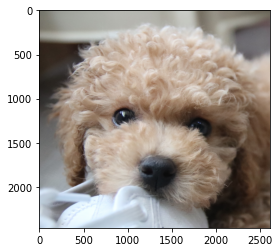

In [45]:
plt.imshow(image)
plt.show()

In [46]:
dir(transforms)[:15]
    # image 데이터들을 변환하는 여러가지가 있다.

['AutoAugment',
 'AutoAugmentPolicy',
 'CenterCrop',
 'ColorJitter',
 'Compose',
 'ConvertImageDtype',
 'FiveCrop',
 'GaussianBlur',
 'Grayscale',
 'InterpolationMode',
 'Lambda',
 'LinearTransformation',
 'Normalize',
 'PILToTensor',
 'Pad']

# Transform on Tensor

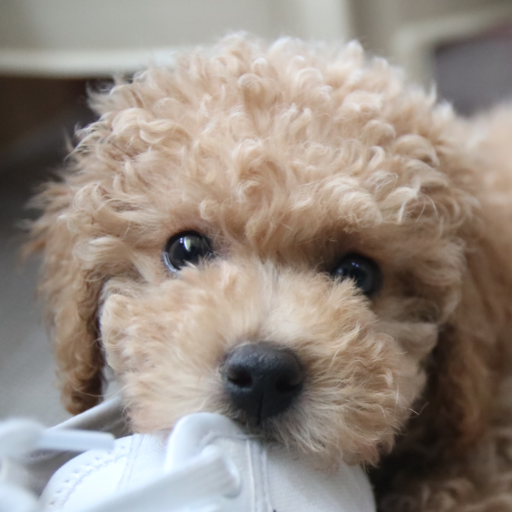

In [47]:
transforms.Resize((512, 512))(image)
            # 그림 사이즈 변경

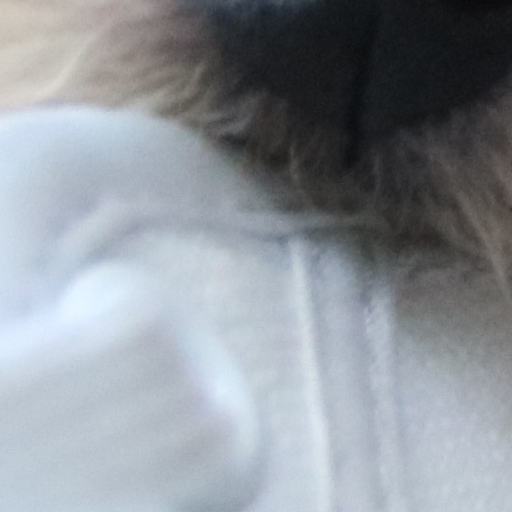

In [48]:
transforms.RandomCrop(size=(512,512))(image)
            # 무작위 부분 crop 하기
            # epoch를 돌 때마다 같은 샘플이지만 다른 학습을 할 수 있게 된다.

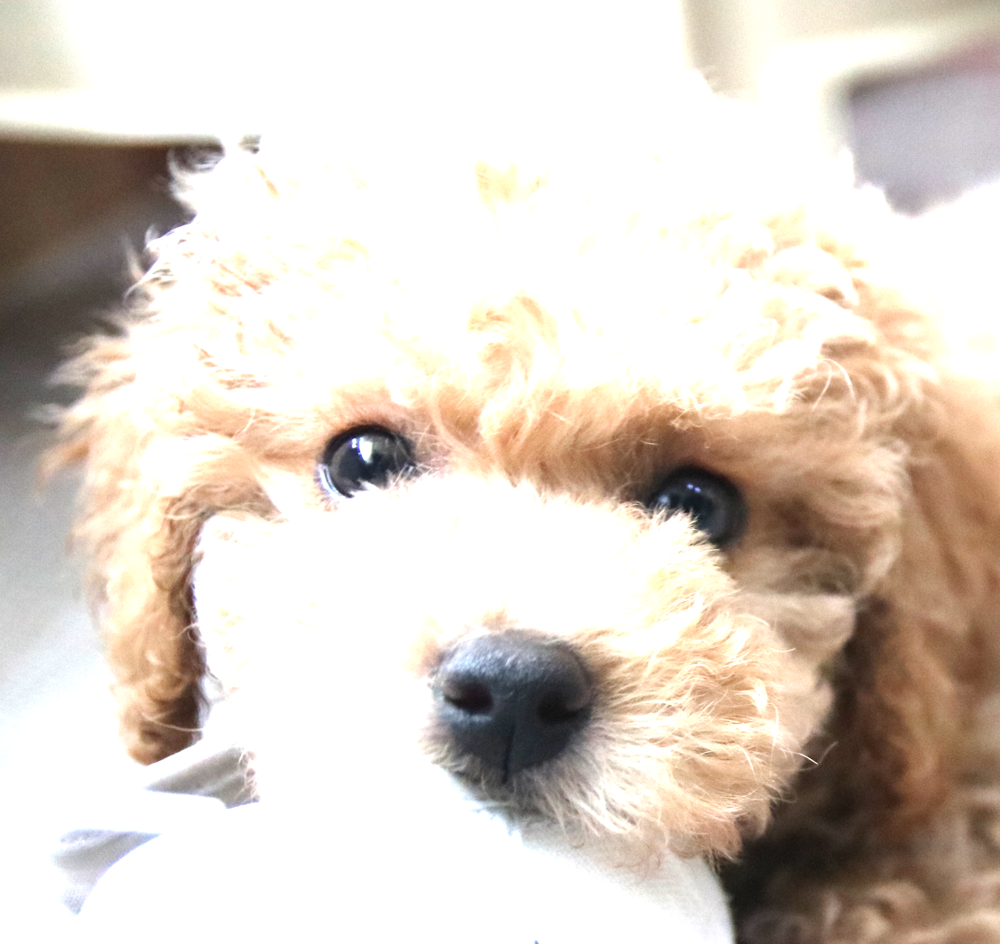

In [49]:
transforms.ColorJitter(brightness=1)(image)
            # 밝기조절

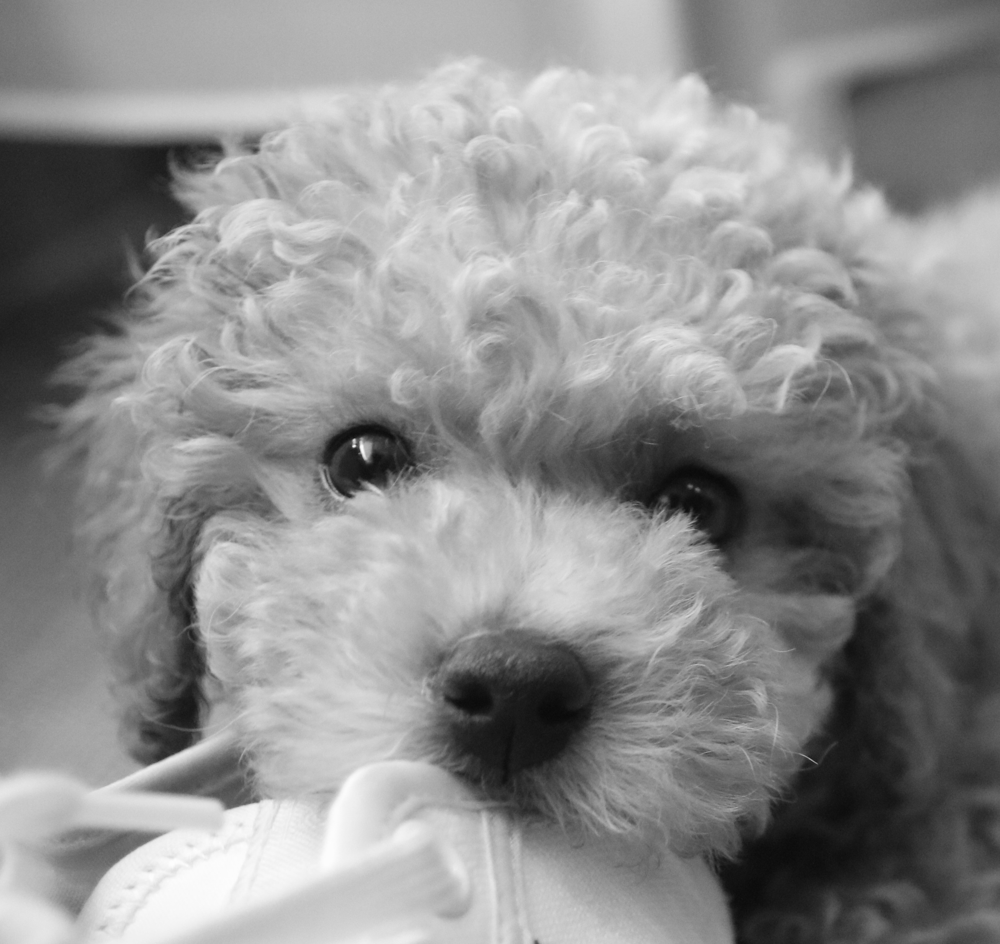

In [50]:
transforms.Grayscale()(image)
            # grayscale 적용

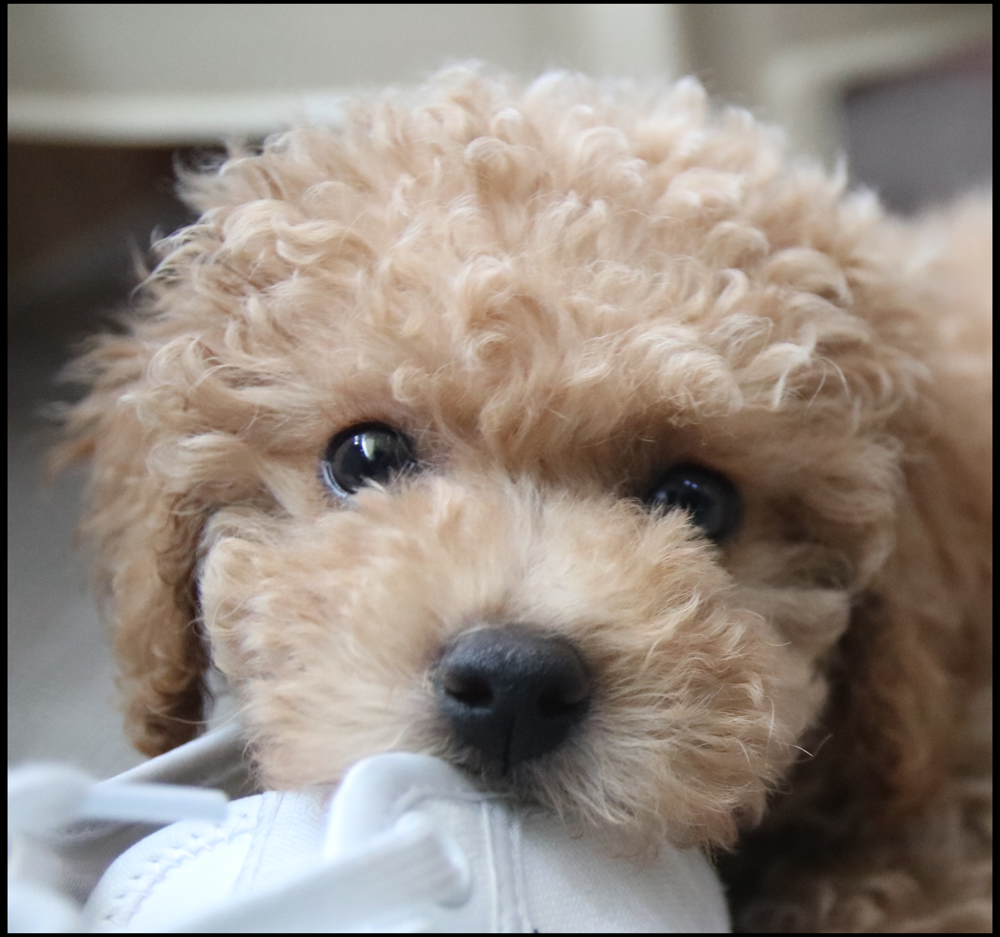

In [51]:
transforms.Pad(padding=(20,10))(image)
            # 테두리 설정

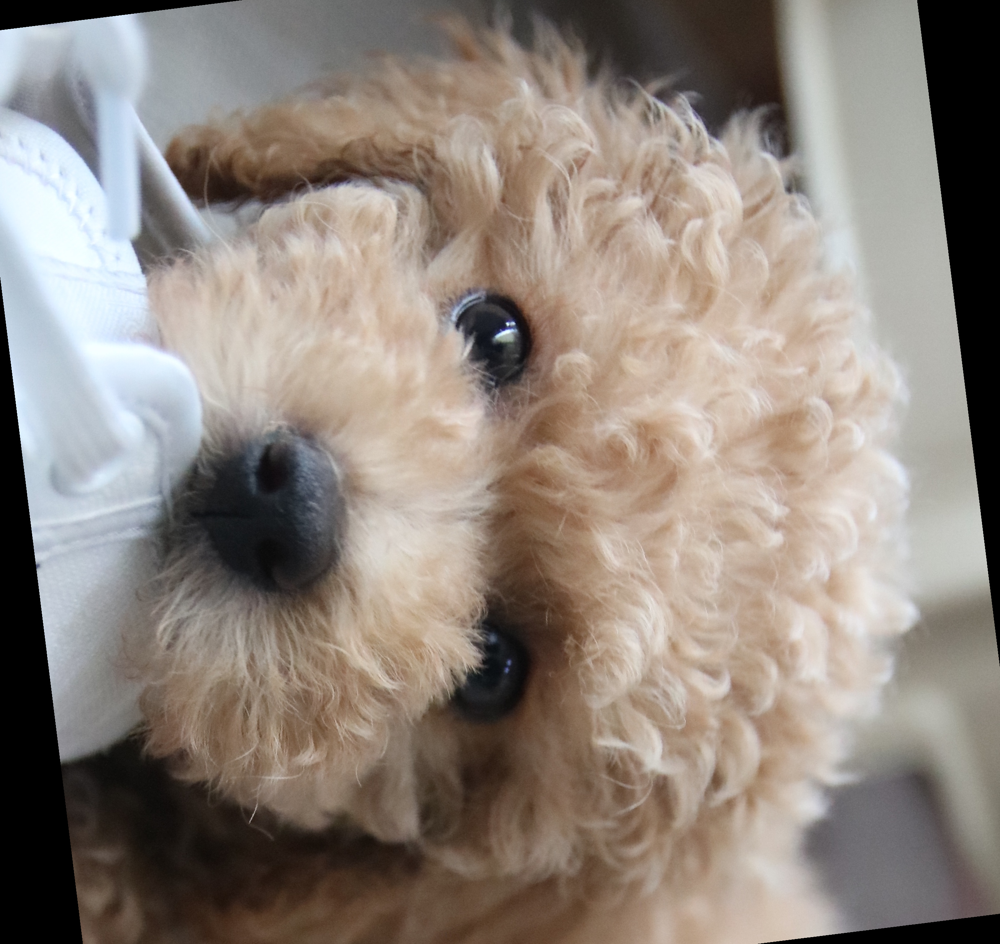

In [52]:
transforms.RandomAffine(degrees=90)(image)
                    # 기울기를 조절하는 것

In [53]:
transform_list=[
    transforms.RandomAffine(degrees=90),
    transforms.Pad(20, 20)
]

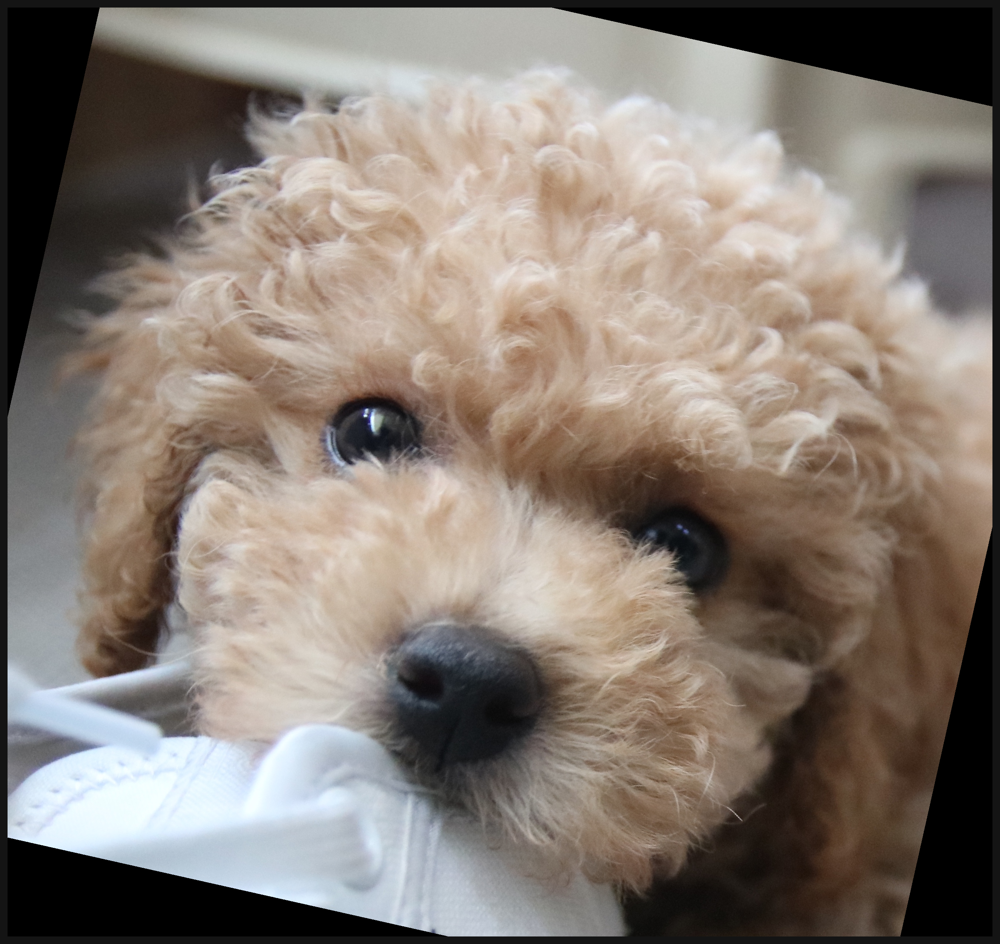

In [54]:
transforms.RandomApply(transform_list, p=0.5)(image)
                                        # p value 0.5 는 반반

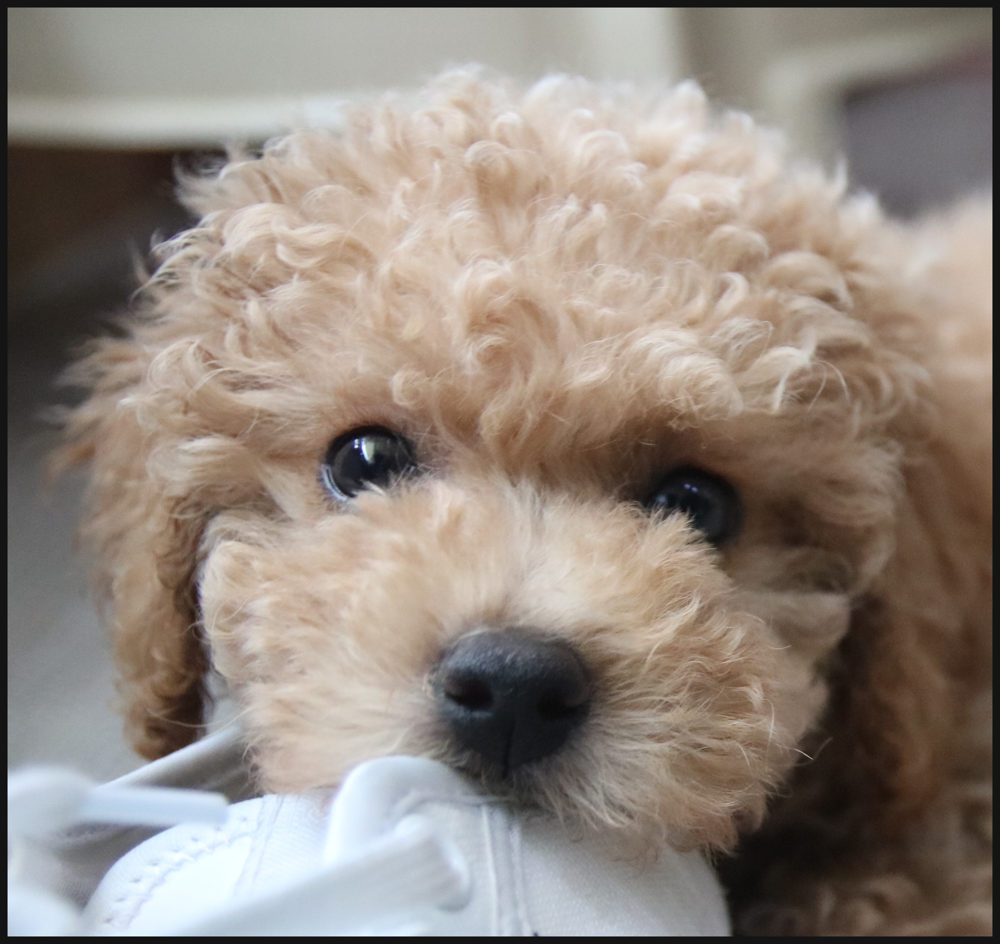

In [55]:
transforms.RandomChoice(transform_list)(image)  
            # List 중에서 하나만 사용하기

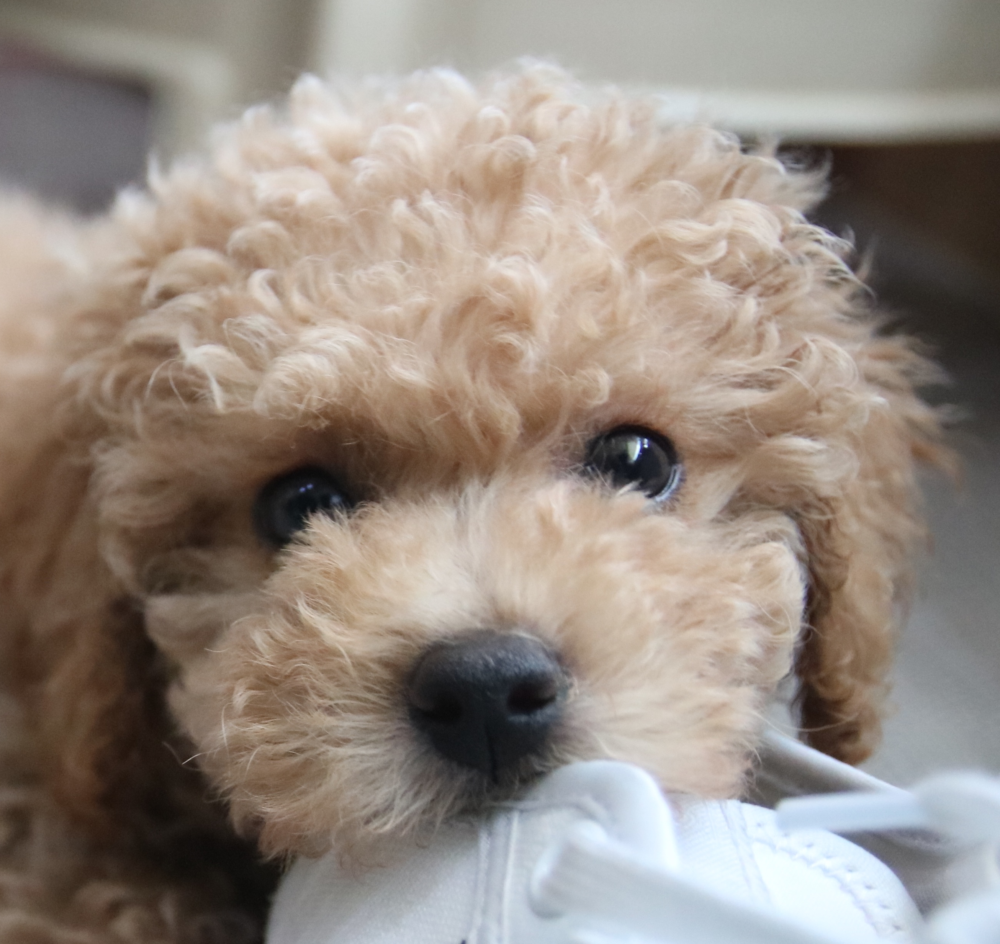

In [56]:
transforms.RandomHorizontalFlip(p=1)(image)
                # 좌우 반전

# Training sample

In [69]:
cifar_dir = '../datasets/cifar/'
train_dir = os.path.join(cifar_dir, 'train')
test_dir = os.path.join(cifar_dir, 'test')

In [70]:
transform = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(brightness=1, contrast=0, saturation=0, hue=0),
    transforms.Resize(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

test_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [71]:
class Dataset(torch.utils.data.Dataset):
    def __init__(self, data_paths, transform=None):
        super(Dataset).__init__()
        self.data_paths = data_paths
        self.transform = transform

    def __len__(self):
        return len(self.data_paths)

    def __getitem__(self, idx):          # idx를 입력하면 해당 idx의 데이터를 가져옴
        path = self.data_paths[idx]
            # 하나의 이미지에 대한 path가 들어있다.
        image = Image.open(path)
        label_name = path.split('.png')[0].split('_')[-1].strip()

        with open(os.path.join(cifar_dir, 'labels.txt'),'r') as f:
            label_list=f.read().strip().split('\n')
            
        label = label_list.index(label_name)

        if self.transform:
            image = self.transform(image)
            
        return image, label

In [72]:
train_dataset = Dataset(data_paths=glob(train_dir + '/*.png'), transform=transform)
test_dataset = Dataset(data_paths=glob(test_dir + '/*.png'), transform=test_transform)

In [73]:
batch_size = 32

In [74]:
train_loader = torch.utils.data.DataLoader(train_dataset,
                                        batch_size=batch_size,
                                        shuffle=True)

test_loader = torch.utils.data.DataLoader(test_dataset,
                                        batch_size=batch_size,
                                        )

In [75]:
class ResidualBlock(nn.Module):
    def __init__(self, in_channel, out_channel):
        super(ResidualBlock, self).__init__()
        
        self.in_channel, self.out_channel = in_channel, out_channel
        
        self.conv1 = nn.Conv2d(in_channel, out_channel, kernel_size=1, padding=0)
        self.conv2 = nn.Conv2d(out_channel, out_channel, kernel_size=3, padding=1)
        self.conv3 = nn.Conv2d(out_channel, out_channel, kernel_size=1, padding=0)
        
        if in_channel != out_channel:
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_channel, out_channel, kernel_size=1, padding=0)
            )
        else:
            self.shortcut = nn.Sequential()
    
    def forward(self, x):
        out = F.relu(self.conv1(x))
        out = F.relu(self.conv2(out))
        out = F.relu(self.conv3(out))
        out = out + self.shortcut(x)
        return out

class ResNet(nn.Module):
    def __init__(self, color='gray'):
        super(ResNet, self).__init__()
        if color == "gray":
            self.conv1 = nn.Conv2d(1, 32, kernel_size=3, stride=1, padding=1)
        elif color == "rgb":
            self.conv1 = nn.Conv2d(3, 32, kernel_size=3, stride=1, padding=1)
            
        self.resblock1 = ResidualBlock(32, 64)
        self.resblock2 = ResidualBlock(64, 64)
        
        self.avgpool = nn.AdaptiveAvgPool2d((1,1))
        self.fc1 = nn.Linear(64, 64)
        self.fc2 = nn.Linear(64, 10)
        
    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.max_pool2d(x, 2, 2)
        x = self.resblock1(x)
        x = self.resblock2(x)
        x = self.avgpool(x)
        x = torch.flatten(x,1)
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        x = F.log_softmax(x, dim=1)
        return x

In [76]:
model = ResNet(color='rgb')

In [81]:
def train_loop(dataloader, model, loss_fn, optimizer, epoch):
    model.train()
    size = len(dataloader)


    for batch, (x, y) in enumerate(dataloader):
        x, y = x.to(device), y.to(device)

        pred = model(x)
        loss = loss_fn(pred, y)

        optimizer.zero_grad()   # 초기화

        loss.backward()     # 미분값 계산

        optimizer.step

        if batch % 100 == 0:
            loss = loss.item()
            print(f'Epoch {epoch} : [{batch}/{size}] loss : {loss}')

    # scheduler.step(loss)

    return loss.item()

def test_loop(dataloader, model, loss_fn, optimizer, epoch):
    model.eval()
    test_loss = 0
    with torch.no_grad():
        for batch, (x,y) in enumerate(dataloader):
            x, y = x.to(device), y.to(device)
            output = model(x)
            test_loss += F.nll_loss(output, y, reduction='sum').item()

    test_loss /= len(dataloader.dataset)
    return test_loss

In [82]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.003)

In [ ]:
for epoch in range(1):
    loss = train_loop(train_loader, model, F.nll_loss, optimizer, epoch)
    test_loss = test_loop(train_loader, model, F.nll_loss, optimizer, epoch)
    print(f'epoch: {epoch} loss : {loss} test_loss : {test_loss}')